In [1]:
using Random, LaTeXStrings , ColorSchemes , Statistics, Base.Iterators, Plots

In [ ]:
#plotlyjs()
gr()


Logistic Map

In [2]:
function  logistic(y , r)       #The Logistic function
    y = 4*r* y*(1-y)
    return y
end


logistic (generic function with 1 method)

In [3]:
n=1000
results = zeros(n,100)
for i in 1:1000          # Loop for different r
    InitVals = rand(100)
    for j in 1:n        # Loop for n run
        InitVals = logistic.(InitVals,i/1000)
    end
    results[i,:] = InitVals
end


Plots

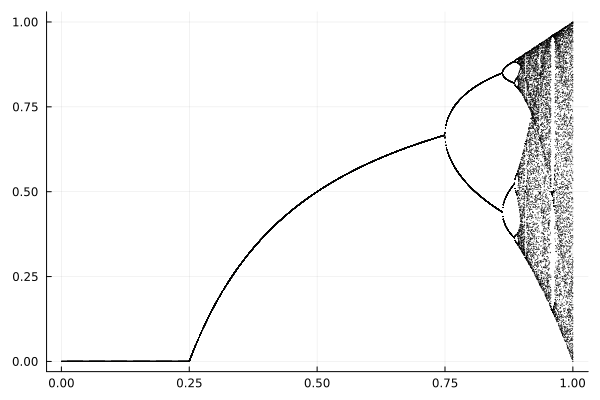

In [5]:
#Plotting
plot()
for i kin 1:1000
    plot!(fill(i/1000,100) , results[i,:], markersize = 0.1 , legend = false, seriestype = :scatter)
end
plot!()

Bifurcation Points

In [4]:
n=10
bifpoints = []
for i in 2 .^[1:n...]
    push!(bifpoints,findfirst(j -> length(unique(round.(results[j,:] , digits=8)))==i,1:1000))  #this line tries to capture points where bifurcation happens in the map.
                                                                                                #by rounding up the digits up to a suitable threshold, the points that are close enough are unified by unique function
                                                                                                #this is done to reduce the noise for finding the first index where the number of points is a power of 2.(dont by length function)
end
print(bifpoints)

Any[254, 864, 887, 892, nothing, 249, nothing, nothing, nothing, nothing]

First Feigenbaum Constant: $\delta$

In [7]:
δ = ((bifpoints[4] -bifpoints[3])/ (bifpoints[3] -bifpoints[2]))^-1                     #with rounding up to 6 digits the result is better but for a reason unknown to me the order of points is not correct. 
                                                                                        #however rounding up to 4 digits gives the points in the correct order but with less accuracy
                                                                                        # rounding up to 8 digits gives the second, third, forth and fifth bifurcation points in good accuracy and order. only the second bifurcation point is missed which is used from other data.

4.6000000000000005

Second Feigenbaum Constant: $\alpha$

In [128]:
width5 = sort(unique((round.(results[bifpoints[4],:],digits=4))))        # for finding the width of each pine, rounding and using unique function is again needed for ommiting points with too lottle distance.
                                                                    # lastly the points are sorted for calculating the distance between each two closer points.
width4 = sort(unique((round.(results[bifpoints[3],:],digits=4))))

width3 = sort(unique((round.(results[bifpoints[2],:],digits=4))))

α = (((width5[16]-width5[15]) - (width4[6]-width4[5]))/ ((width4[6]-width4[5]) - (width3[2]-width3[1])))^-1         #according to wikipedia: is the ratio between the width of a tine and the width of one of its two subtines (except the tine closest to the fold).

2.7889908256880616